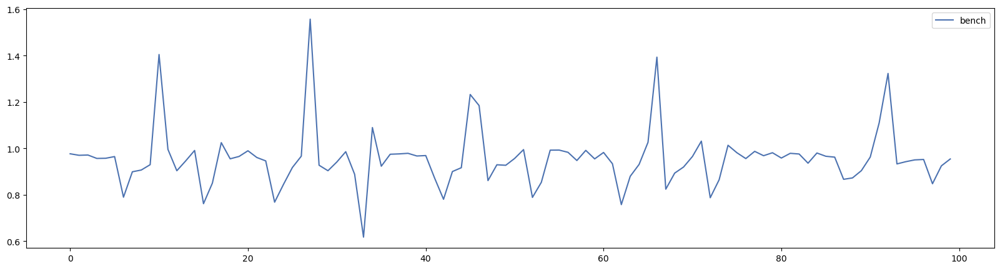

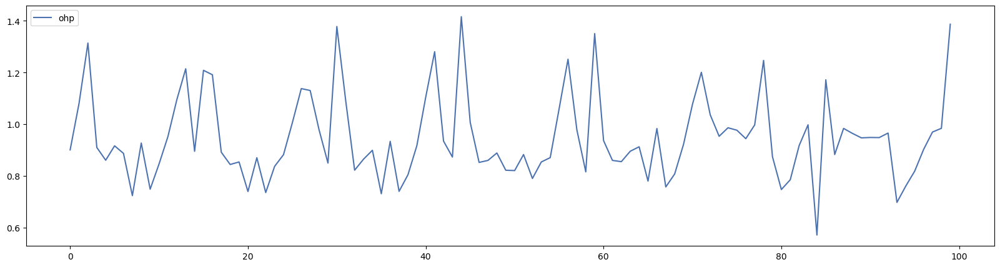

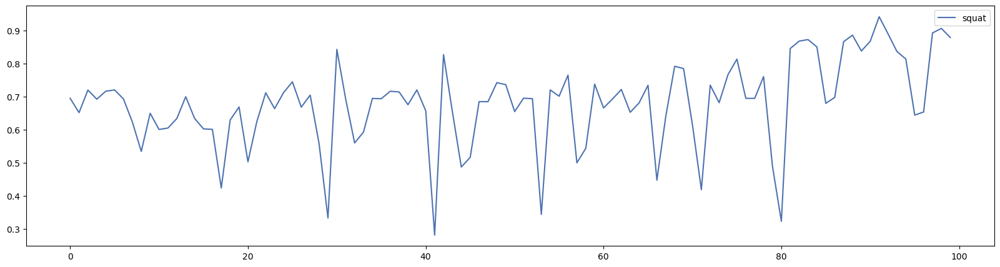

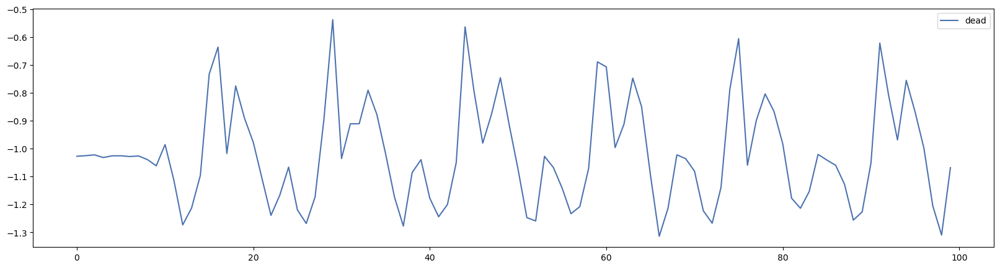

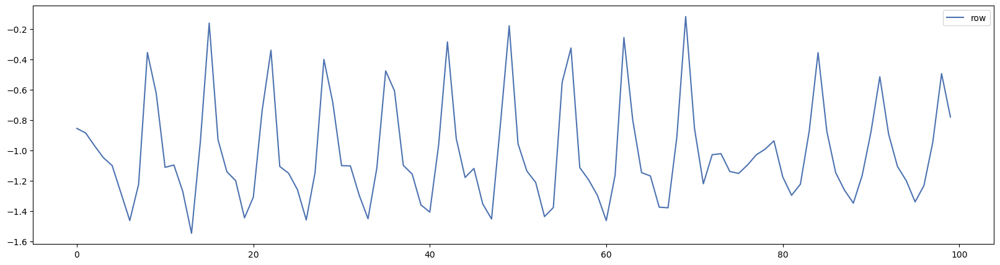

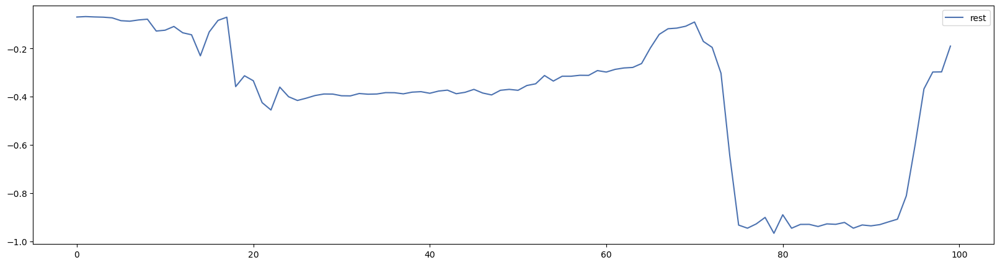

,acc-x,acc-y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 16:05:44.600,0.135333,0.694667,0.735333,2.5366,-0.6220,1.6098,A,squat,medium,50
2019-01-11 16:05:44.800,0.097500,0.651500,0.658000,2.0854,0.0366,0.1952,A,squat,medium,50
2019-01-11 16:05:45.000,0.148667,0.719667,0.694333,-0.0364,1.2562,0.0242,A,squat,medium,50
2019-01-11 16:05:45.200,0.138000,0.692000,0.632000,5.9878,-4.5734,1.0976,A,squat,medium,50
2019-01-11 16:05:45.400,0.131667,0.716000,0.658000,-4.1586,-2.9636,-0.5852,A,squat,medium,50
...,...,...,...,...,...,...,...,...,...,...
2019-01-18 17:04:06.800,0.123000,0.802333,0.541333,3.9510,-1.1220,0.4634,D,squat,heavy,52
2019-01-18 17:04:07.000,0.118500,0.812500,0.535000,-3.4390,-0.8536,0.6222,D,squat,heavy,52
2019-01-18 17:04:07.200,0.116000,0.801000,0.543333,-1.3172,-0.7806,1.4754,D,squat,heavy,52


In [82]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from IPython.display import display

# --------------------------------------------------------------
# Load data
# --------------------------------------------------------------
df=pd.read_pickle("/home/ojas-srivastava/Desktop/data-science-template-main/data/interim/done.pkl")
# df.head()

# --------------------------------------------------------------
# Plot single columns
# --------------------------------------------------------------
set_df=df[df["set"]==1]#selecting subsets of a dataframe
# set_df
# plt.plot(set_df["acc-x"])
# plt.plot(set_df["acc-x"].reset_index(drop=True))#teimestamp index updat

# --------------------------------------------------------------
# Plot all exercises
# --------------------------------------------------------------
for label in df["label"].unique():
    subset=df[df["label"]==label]
    # display(subset.head(2))
    fig,ax=plt.subplots()
    plt.plot(subset[:100]["acc-y"].reset_index(drop=True),label=label)
    plt.legend()
    plt.show()



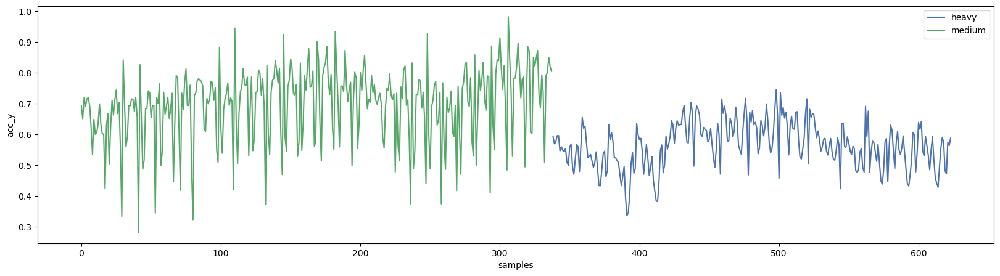

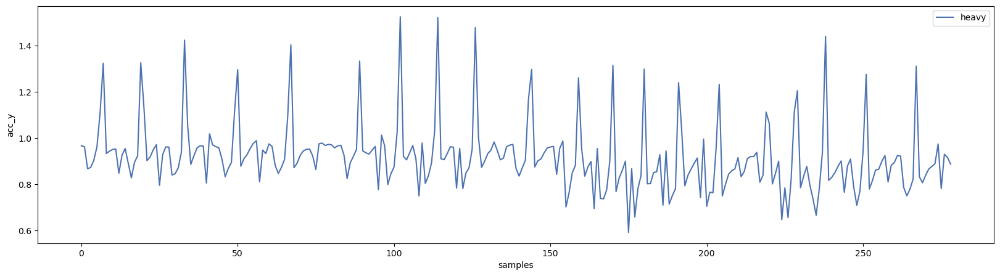

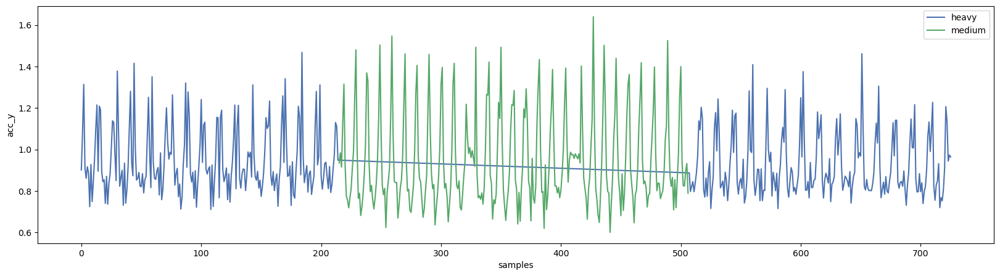

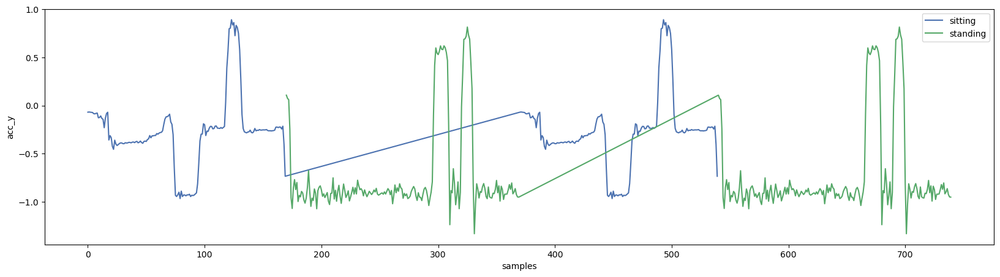

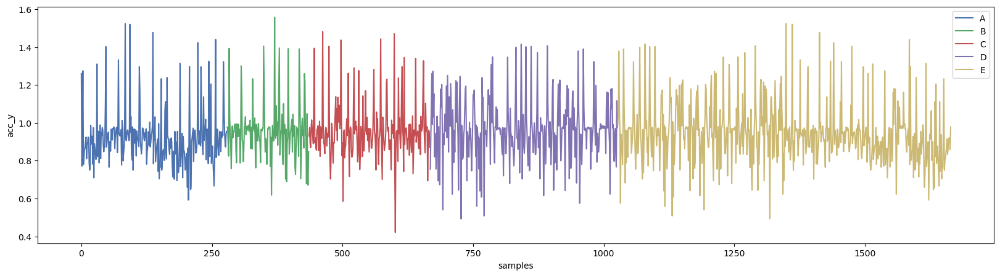

In [124]:
# --------------------------------------------------------------
# Adjust plot settings
# --------------------------------------------------------------
#get them wider to have a better view at the plots
mpl.style.use("seaborn-v0_8-deep")
mpl.rcParams["figure.figsize"]=(20,5)
mpl.rcParams["figure.dpi"]=100

# --------------------------------------------------------------
# Compare medium vs. heavy sets
# --------------------------------------------------------------

category_df=df.query("label=='squat'").query("participant=='A'").reset_index()
fig,ax=plt.subplots()
category_df.groupby(["category"])["acc-y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

category_df=df.query("label=='bench'").query("participant=='A'").reset_index()
fig,ax=plt.subplots()
category_df.groupby(["category"])["acc-y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

category_df=df.query("label=='ohp'").query("participant=='A'").reset_index()
fig,ax=plt.subplots()
category_df.groupby(["category"])["acc-y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()

category_df=df.query("label=='rest'").query("participant=='A'").reset_index()
fig,ax=plt.subplots()
category_df.groupby(["category"])["acc-y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()
# --------------------------------------------------------------
# Compare participants
# --------------------------------------------------------------
participant_df=df.query("label=='bench'").sort_values("participant").reset_index()
fig,ax=plt.subplots()
participant_df.groupby(["participant"])["acc-y"].plot()
ax.set_ylabel("acc_y")
ax.set_xlabel("samples")
plt.legend()
# --------------------------------------------------------------


/tmp/ipykernel_5170/3752651739.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax=plt.subplots()


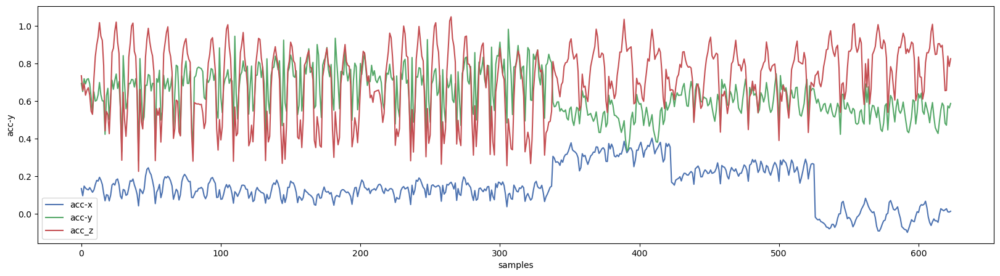

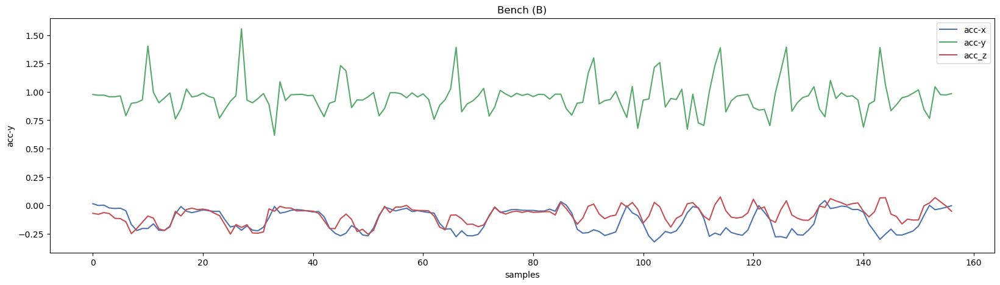

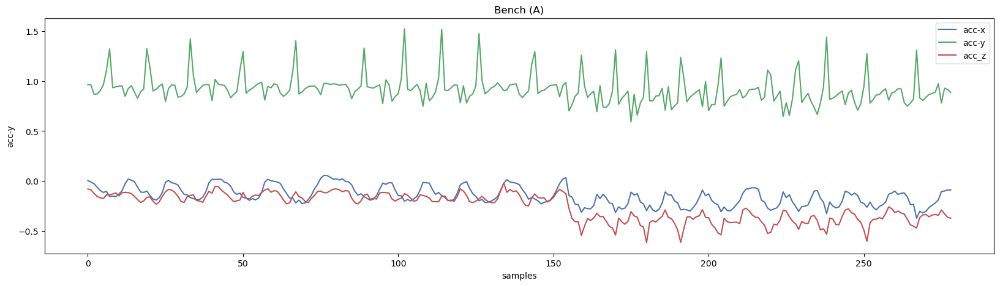

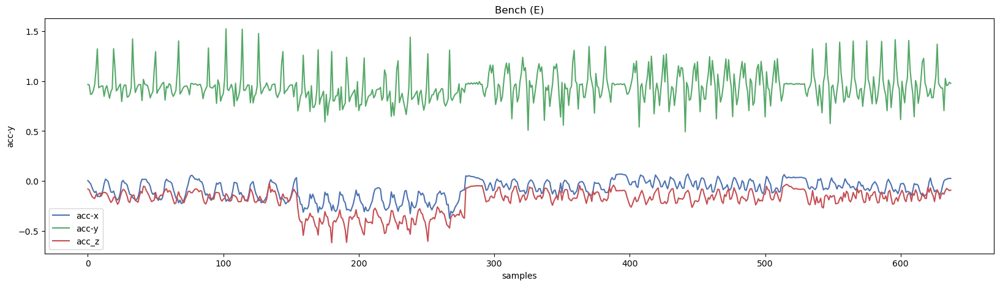

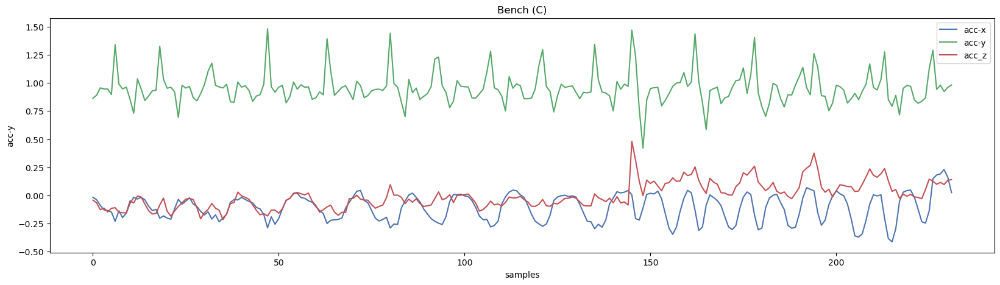

...

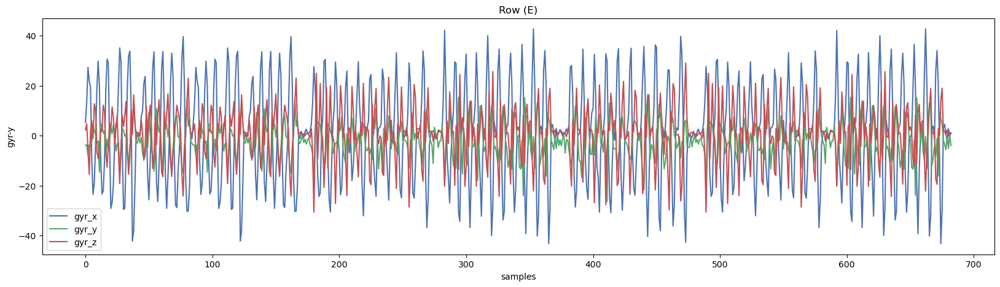

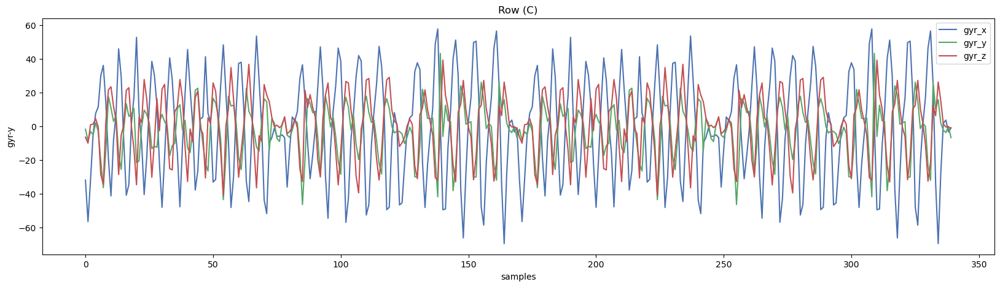

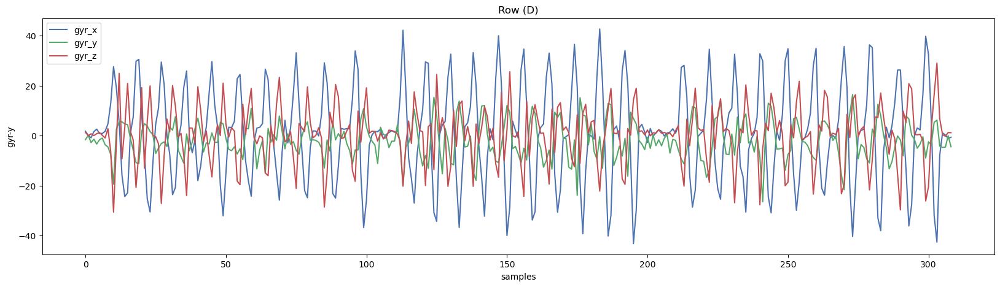

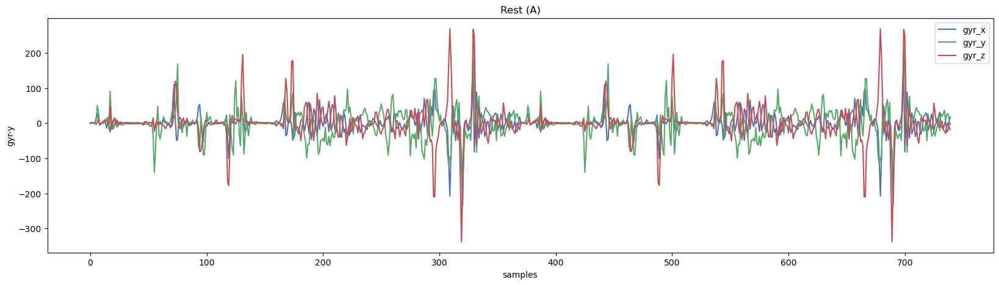

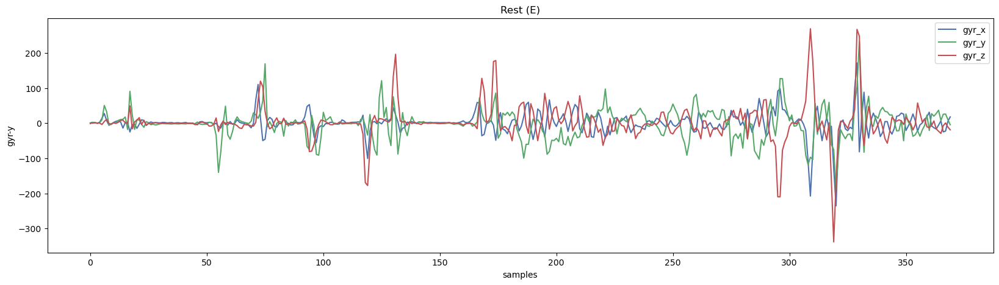

In [194]:
# Plot multiple axis
# --------------------------------------------------------------
label="squat"
participant="A"
all_axis_df=df.query(f"label=='{label}'").query(f"participant=='{participant}'").reset_index()

fig,ax=plt.subplots()
all_axis_df[["acc-x","acc-y","acc_z"]].plot(ax=ax)
ax.set_ylabel("acc-y")
ax.set_xlabel("samples")
plt.legend()
# --------------------------------------------------------------
# Create a loop to plot all combinations per sensor
# --------------------------------------------------------------
labels=df["label"].unique()
participants=df["participant"].unique()
for label in labels:
    for participant in participants:
        
        all_axis_df=(
            df.query(f"label=='{label}'")
            .query(f"participant=='{participant}'")
            .reset_index()
        )
        if(len(all_axis_df)>0):
            
            fig,ax=plt.subplots()
            all_axis_df[["acc-x","acc-y","acc_z"]].plot(ax=ax)
            ax.set_ylabel("acc-y")
            ax.set_xlabel("samples")
            plt.title(f"{label.capitalize()} ({participant})")
            plt.legend()
for label in labels:
    for participant in participants:
        
        all_axis_df=(
            df.query(f"label=='{label}'")
            .query(f"participant=='{participant}'")
            .reset_index()
        )
        if(len(all_axis_df)>0):
            
            fig,ax=plt.subplots()
            all_axis_df[["gyr_x","gyr_y","gyr_z"]].plot(ax=ax)
            ax.set_ylabel("gyr-y")
            ax.set_xlabel("samples")
            plt.title(f"{label.capitalize()} ({participant})")
            plt.legend()

        
        



<Axes: >

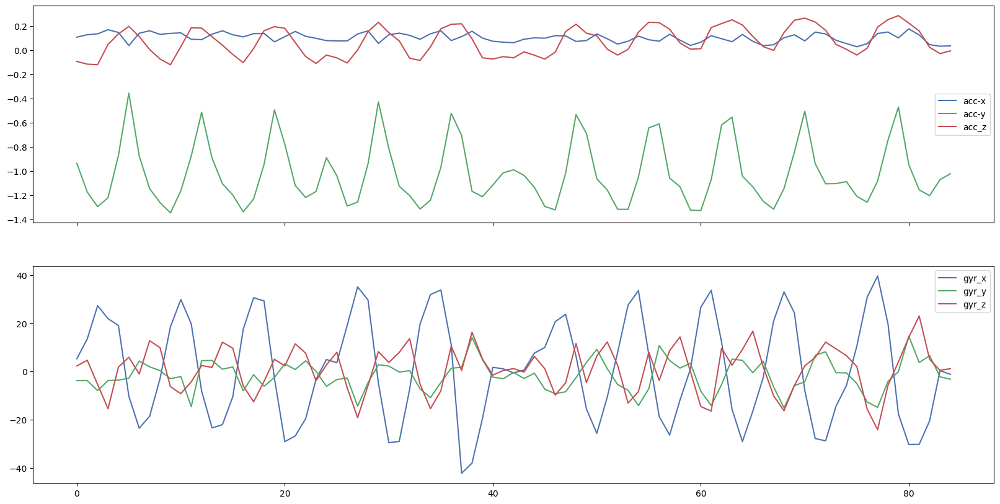

In [198]:
# --------------------------------------------------------------
# Combine plots in one figure
# --------------------------------------------------------------
label="row"
participant="A"
combined_plot_df=(
    df.query(f"label=='{label}'")
    .query(f"participant =='{participant}'")
    .reset_index(drop=True)


)
fig,ax=plt.subplots(nrows=2,sharex=True,figsize=[20,10])
combined_plot_df[["acc-x","acc-y","acc_z"]].plot(ax=ax[0])
combined_plot_df[["gyr_x","gyr_y","gyr_z"]].plot(ax=ax[1])

# --------------------------------------------------------------
# Loop over all combinations and export for both sensors
# --------------------------------------------------------------

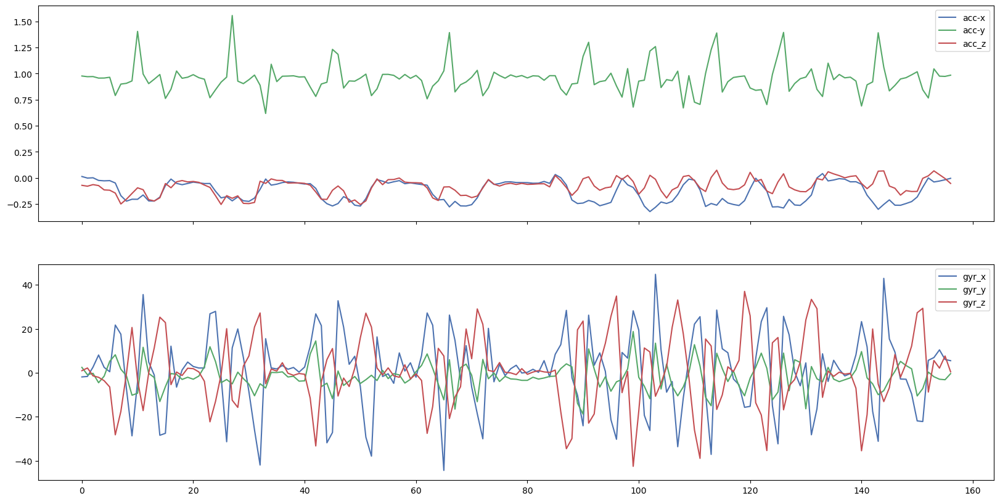

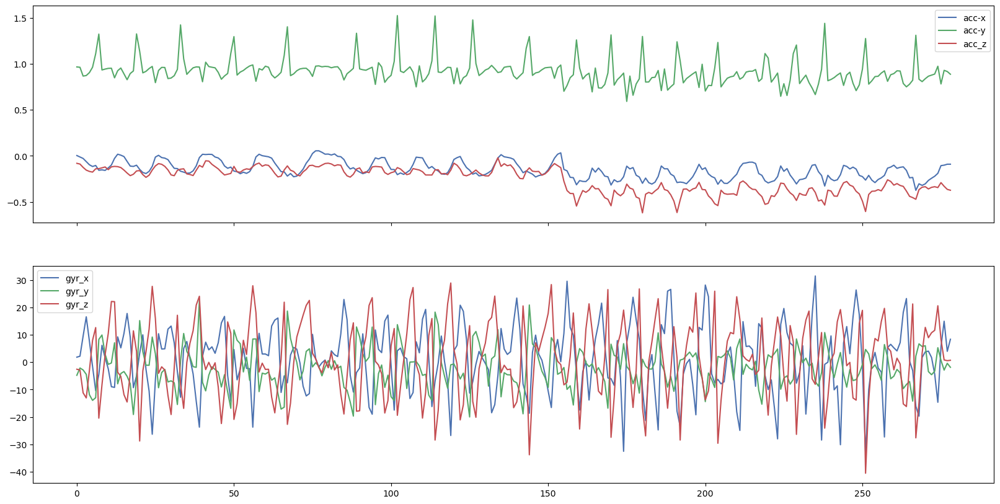

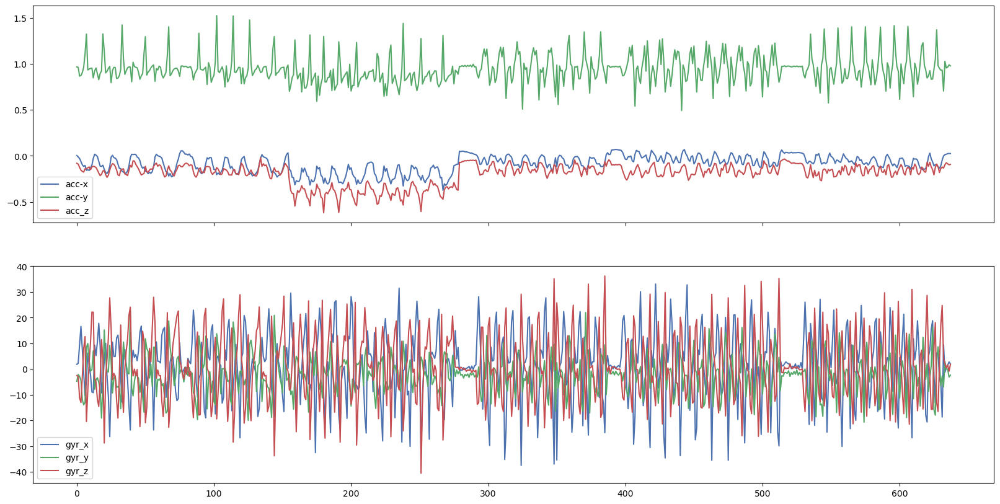

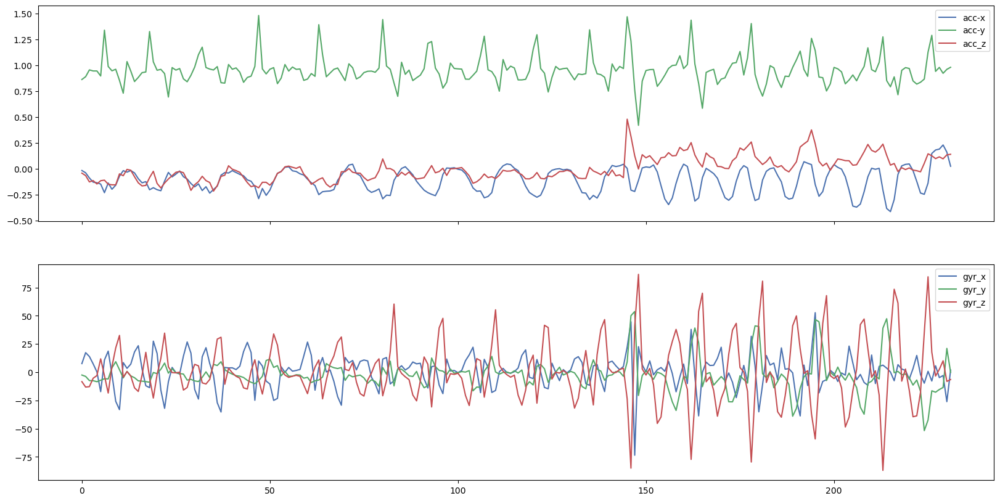

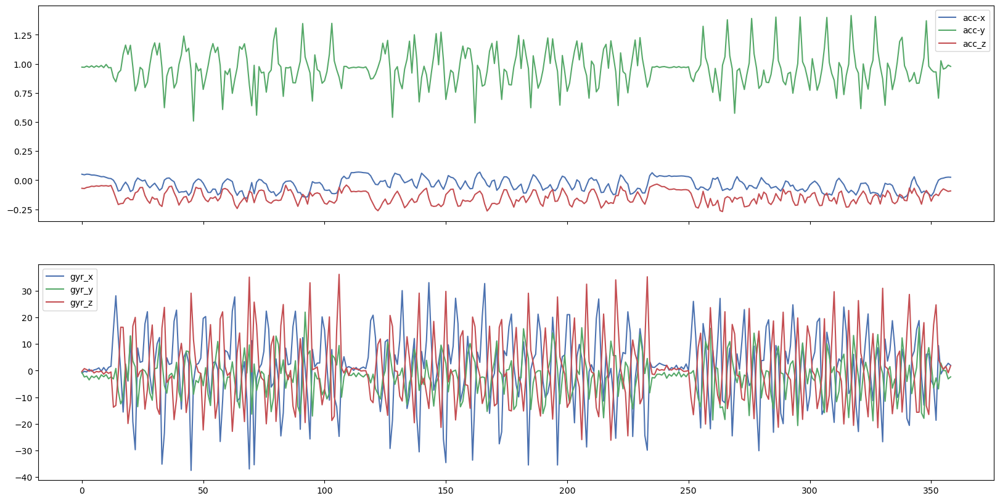

...

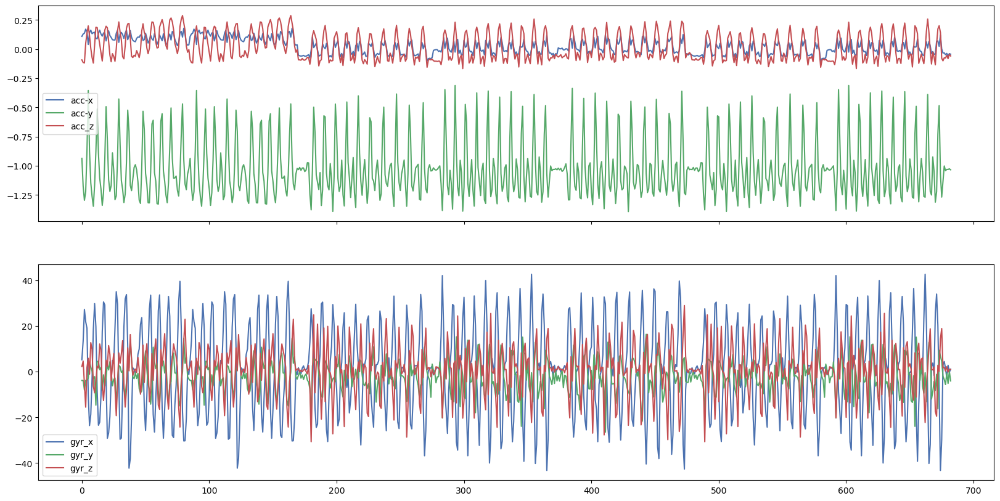

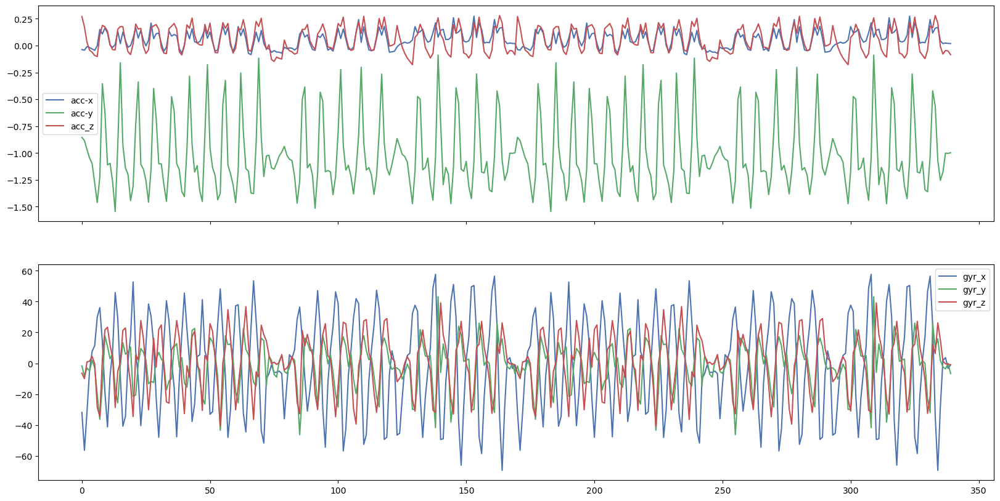

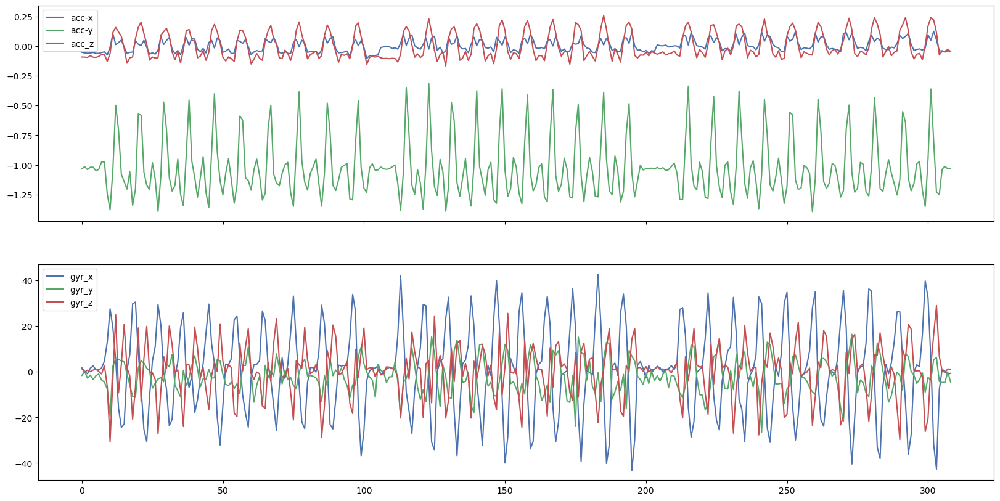

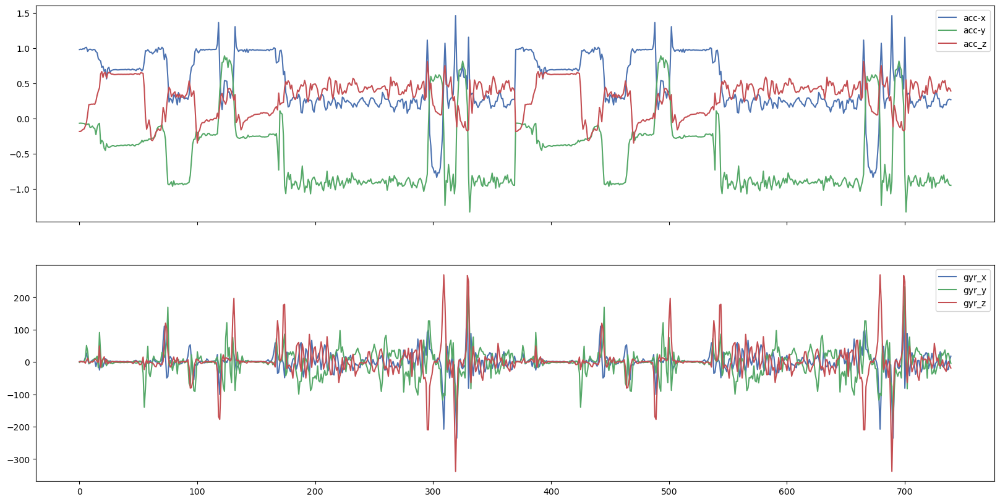

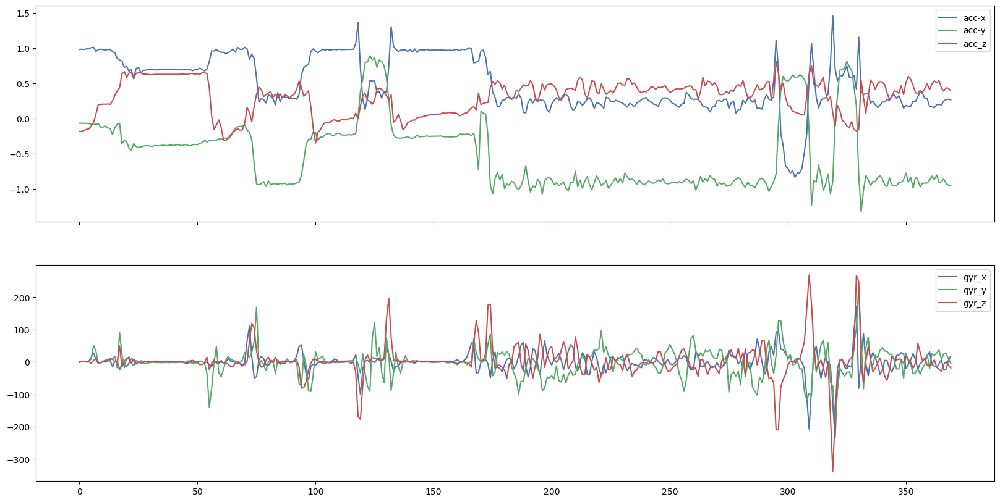

In [214]:
labels=df["label"].unique()
participants=df["participant"].unique()
for label in labels:
    for participant in participants:
        
        combined_plot_df=(
            df.query(f"label=='{label}'")
            .query(f"participant=='{participant}'")
            .reset_index()
        )
        if(len(combined_plot_df)>0):
            fig,ax=plt.subplots(nrows=2,sharex=True,figsize=[20,10])
            combined_plot_df[["acc-x","acc-y","acc_z"]].plot(ax=ax[0])
            combined_plot_df[["gyr_x","gyr_y","gyr_z"]].plot(ax=ax[1])
            plt.savefig(f"/home/ojas-srivastava/Desktop/data-science-template-main/reports/figures/{label.title()} ({participant}).png")
            plt.show()

            
            